# 5. Using time-series metadata (mESC Cytof)
In many developmental or longitudinal studies, the ages, experimental or developmental times are known. When such sampling point metadata are available, they can prove useful in guiding the graph construction and elucidating downstream analysis.
The bottom of this tutorial shows what happens to the TI and visualization when you do not use the (time-series) sequential information to guide the analysis.

This example uses a mouse embryonic stem cell (mESC) differentiation time course collected with mass cytometry. This particularly example looks at the cells cultured in conditions favouring differentiation into the mesoderm lineage. Samples are collected over an 11 day period. 

### Load the data

The dataset consists of 89782 cells comprising ~ 7000 cells randomly sampled across each time point. 

In [1]:
import scanpy as sc
import matplotlib.pyplot as plt
import pyVIA.core as via #from core_working import *
import pandas as pd
import numpy as np


data = pd.read_csv('/home/user/Trajectory/Datasets/mESC/mESC_7000perDay_noscaling_meso.csv')

marker_meso = ['Sca-1', 'CD41', 'Nestin', 'Desmin', 'CD24', 'FoxA2', 'Oct4', 'CD45', 'Ki67', 'Vimentin',
                     'Cdx2', 'Nanog', 'pStat3-705', 'Sox2', 'Flk-1', 'Tuj1', 'H3K9ac', 'Lin28', 'PDGFRa', 'EpCAM',
                     'CD44', 'GATA4', 'Klf4', 'CCR9', 'p53', 'SSEA1', 'bCatenin', 'IdU']
true_labels_numeric= data['day'].tolist()
print(f"Time series sampling points (days) {set(true_labels_numeric)}")
data = data[marker_meso] #using the subset of markers in the original paper

scale_arcsinh = 5 #commonly used arcsinh transformation for mass cytometry data
raw = data.values
raw = raw.astype('float')
raw = raw / scale_arcsinh
raw = np.arcsinh(raw)

adata = sc.AnnData(raw)
adata.var_names = data.columns
adata.obs['day_str'] = [str(i) for i in true_labels_numeric]
print(f"anndata shape {adata.shape}")

Time series sampling points (days) {0.0, 1.0, 2.0, 2.5, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0}
anndata shape (89782, 28)


## Initialize and run VIA
You can play around with the graph-pruning parameters impacting the clustering granularity 
- `edgepruning_clustering_resolution`  (float values between 0-1). larger values larger (but fewer) clusters
- `the cluster_graph_pruning` (float values between 0-1) larger values retains more edges/connectivity
- `root` (list) provide the cell index or a group-level label. We know that the initial state is at Day 0.0 so we allow Via to find the location of Day 0.0 cells that best fits an initial cluster. If using a group-level label, it must be an item found in true_label

### Time-series/sequential metadata related paramters

In order to guide the trajectory inference with the available time-series labels, we need to set certain parameters.
- `time_series paramter = True`
- `time_series_labels` (numeric time-series values of each cell).
- `knn_sequential` to control the level of connectivity with adjacent time points. 
- `t_diff_step` (default =2) number of incremental steps of time difference allowed between non-temporally-adjacent edges 

 Note that the `true_label` parameter is purely for reference when available (based on clustering annotations or can be omitted) and does not impact the TI except for allowing you to color-code cells in later visualizations based on any labels you have. If you don't provide a true_label parameter, Via just generates a dummy set of labels and the TI computations will remain unchanged. Of course in this case, you would not be able to assign a group-level root_user since that would have to correspond to a true_label and instead you can allow random or rna-velocity guided root selection or choose a cell index (int). 

In [39]:
knn=40
cluster_graph_pruning = 0.15
edgepruning_clustering_resolution=0.3
random_seed = 0
knn_sequential = 20

root = [0.0] #since the root corresponds to a group level initial state  we set dataset = 'group'
v0 = via.VIA(adata.X, true_label=true_labels_numeric, edgepruning_clustering_resolution=edgepruning_clustering_resolution, edgepruning_clustering_resolution_local=1, knn=knn,
         cluster_graph_pruning=cluster_graph_pruning,  piegraph_arrow_head_width=0.6,
         too_big_factor=0.3, resolution_parameter=1,
         root_user=root, dataset='group', random_seed=random_seed,
         is_coarse=True, preserve_disconnected=False, pseudotime_threshold_TS=40, x_lazy=0.99,
         alpha_teleport=0.99, time_series=True, time_series_labels=true_labels_numeric, t_diff_step=2,
         edgebundle_pruning_twice=False, knn_sequential=knn_sequential, knn_sequential_reverse=knn_sequential)
v0.run_VIA()

2023-10-10 14:59:52.060765	Running VIA over input data of 89782 (samples) x 28 (features)
2023-10-10 14:59:52.061403	Knngraph has 40 neighbors
2023-10-10 15:00:09.377507	Using time series information to guide knn graph construction 
2023-10-10 15:00:09.384511	Time series ordered set [0.0, 1.0, 2.0, 2.5, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0]
2023-10-10 15:01:17.441564	Shape neighbors (89782, 40) and sequential neighbors (89782, 40)
2023-10-10 15:01:17.477229	Shape augmented neighbors (89782, 80)
2023-10-10 15:01:17.501867	Actual average allowable time difference between nodes is 1.8333
2023-10-10 15:01:38.278760	Finished global pruning of 40-knn graph used for clustering at level of 0.3. Kept 55.2 % of edges. 
2023-10-10 15:01:38.382642	Number of connected components used for clustergraph  is 1
2023-10-10 15:01:51.584327	Commencing community detection
2023-10-10 15:01:56.752912	Finished running Leiden algorithm. Found 24 clusters.
2023-10-10 15:01:56.778275	Merging 8 very small

/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/pecanpy/graph.py:90: UserWarning: WARNING: Implicitly set node IDs to the canonical node ordering due to missing IDs field in the raw CSR npz file. This warning message can be suppressed by setting implicit_ids to True in the read_npz function call, or by setting the --implicit_ids flag in the CLI
  warnings.warn(


  0%|          | 0/1300 [00:00<?, ?it/s]

memory for rw2 hittings times  2. Using rw2 based pt
do scaling of pt
2023-10-10 15:02:01.110005	Identifying terminal clusters corresponding to unique lineages...
2023-10-10 15:02:01.110035	Closeness:[1, 2, 9, 11, 12, 13]
2023-10-10 15:02:01.110046	Betweenness:[1, 2, 6, 7, 8, 9, 12, 13, 15]
2023-10-10 15:02:01.110053	Out Degree:[1, 2, 3, 4, 9, 10, 11, 12, 13, 14, 15]
2023-10-10 15:02:01.110263	Cluster 1 had 3 or more neighboring terminal states [2, 11, 12] and so we removed cluster 11
2023-10-10 15:02:01.110421	Terminal clusters corresponding to unique lineages in this component are [1, 2, 12, 15] 
TESTING rw2_lineage probability at memory 5
testing rw2 lineage probability at memory 5
g.indptr.size, 17


/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/pecanpy/graph.py:90: UserWarning: WARNING: Implicitly set node IDs to the canonical node ordering due to missing IDs field in the raw CSR npz file. This warning message can be suppressed by setting implicit_ids to True in the read_npz function call, or by setting the --implicit_ids flag in the CLI
  warnings.warn(


  0%|          | 0/1000 [00:00<?, ?it/s]

2023-10-10 15:02:03.743076	 Cluster or terminal cell fate 1 is reached 188.0 times
2023-10-10 15:02:03.773171	 Cluster or terminal cell fate 2 is reached 168.0 times
2023-10-10 15:02:03.801709	 Cluster or terminal cell fate 12 is reached 187.0 times
2023-10-10 15:02:03.827094	 Cluster or terminal cell fate 15 is reached 821.0 times
2023-10-10 15:02:03.850863	There are (4) terminal clusters corresponding to unique lineages {1: 10.0, 2: 9.0, 12: 9.0, 15: 5.0}
2023-10-10 15:02:03.850908	Begin projection of pseudotime and lineage likelihood
2023-10-10 15:02:08.218722	Start reading data
2023-10-10 15:02:08.218789	Correlation of Via pseudotime with developmental stage 92.75 %
2023-10-10 15:02:08.229551	Cluster graph layout based on forward biasing
2023-10-10 15:02:08.230564	Starting make edgebundle viagraph...
2023-10-10 15:02:08.230584	Make via clustergraph edgebundle
2023-10-10 15:02:08.407972	Hammer dims: Nodes shape: (16, 2) Edges shape: (66, 3)
2023-10-10 15:02:08.409930	Graph has 1 con

/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/scipy/sparse/_index.py:103: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_intXint(row, col, x.flat[0])


### Plot the viagraph
Note that the clusters circled in red correspond to the identified (predicted) terminal fates and since we know the time-samples, we can see they correspond to cells in the final stages of development from Day 10-11.

/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/pyVIA/plotting_via.py:3092: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  sct = ax.scatter(node_pos[:, 0], node_pos[:, 1],


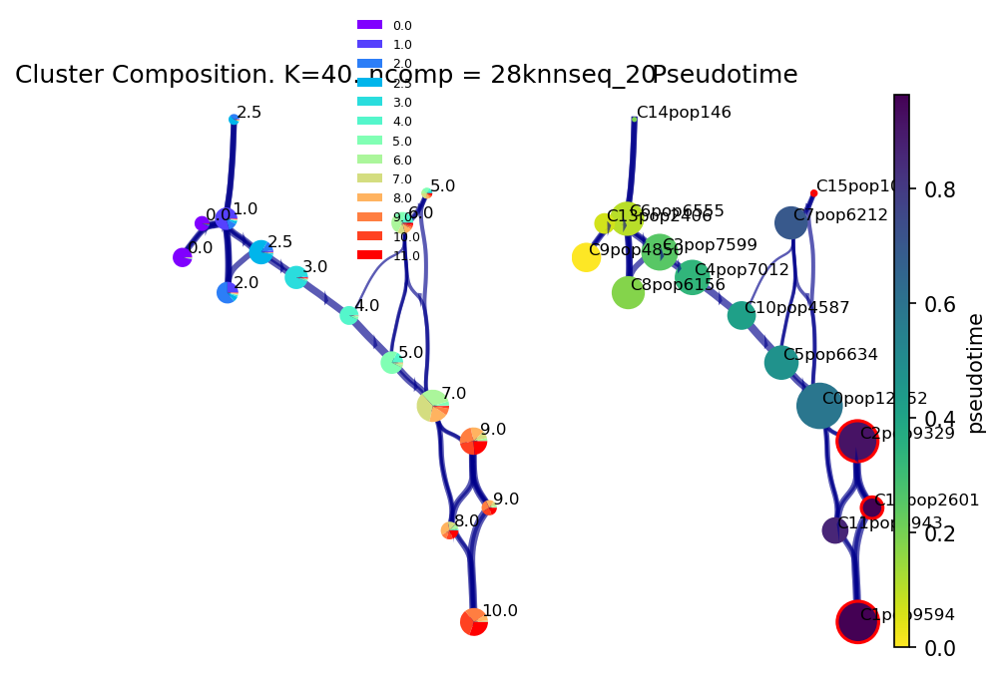

In [40]:
f, ax1, ax2 = via.plot_piechart_viagraph(via_object=v0)

### Protein Marker Dynamics
We expect the lineages associated with the differentiated mesoderm cells(Day 10/11 cells) to show an increase in *Cd44, gata4* and *pdgfra* and a decrease in *Epcam*
The Epcam high Lineage from Cluster 15 actually contains several day 9/10 cells  

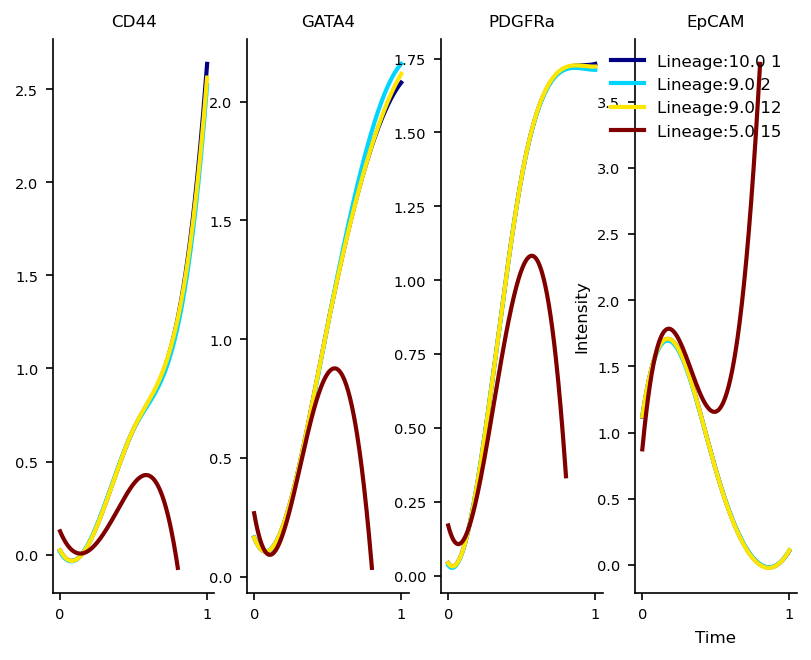

In [44]:
marker_genes = ['CD44', 'GATA4', 'PDGFRa', 'EpCAM']
df_genes = pd.DataFrame(adata[:, marker_genes].X)
df_genes.columns = marker_genes
f, axs= via.get_gene_expression(via_object=v0,gene_exp=df_genes, spline_order=3, n_splines=5)
plt.show()

### The Atlas Embedding
We use the knn-graph constructed in VIA which incorporates the sequential information in order to generate a 2D embedding of the data

In [41]:
atlas_embedding = via.via_atlas_emb(via_object=v0, min_dist=0.2, init_pos='via')
    #via.run_atlas_emb(vi, graph=v0.csr_full_graph, n_components=2, spread=1.0, min_dist=0.3,                  init_pos='spectral', random_state=1, n_epochs=150))


X-input (89782, 28)
len membership and n_cells 89782 89782
n cell 89782
2023-10-10 15:03:03.170901	Computing embedding on sc-Viagraph
2023-10-10 15:03:03.235140	using via cluster graph to initialize embedding


  0%|          | 0/100 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


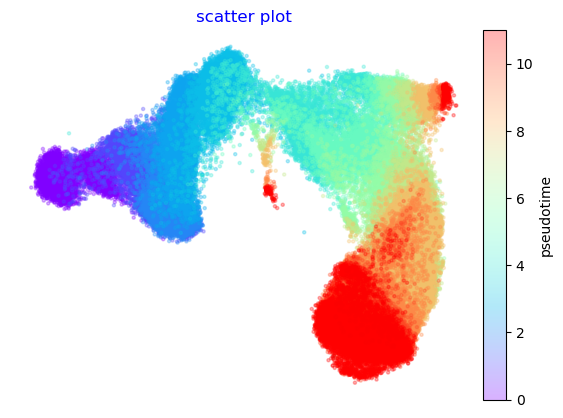

In [43]:
f,ax=via.plot_scatter(embedding=atlas_embedding, labels= true_labels_numeric)

### Streamplots for Cytof data
The cluster-level trajectory is projected onto the 2D embedding to visualize the more fine-grained progression

/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/scipy/sparse/_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/pyVIA/core.py:1287: RuntimeWarning: divide by zero encountered in divide
  T = T.multiply(csr_matrix(1.0 / np.abs(T).sum(1)))  # rows sum to one
/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/pyVIA/core.py:1318: RuntimeWarning: Mean of empty slice.
  V_emb[i] = probs.dot(dX) - probs.mean() * dX.sum(0)
/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


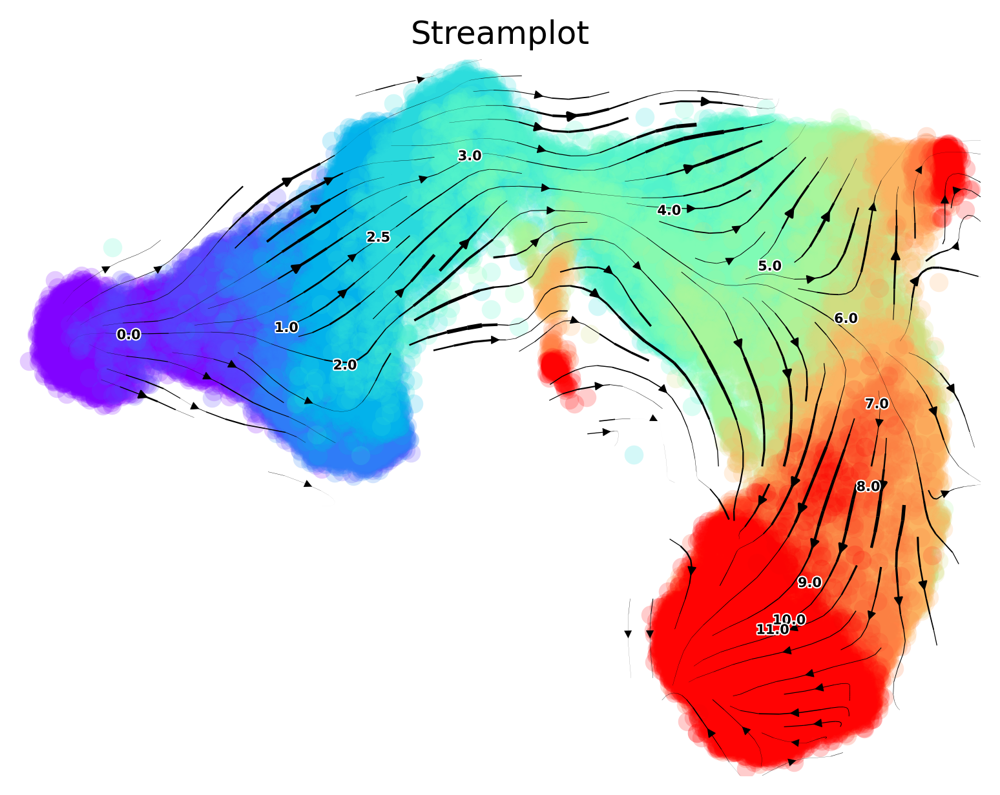

In [46]:
via.via_streamplot(v0, embedding=atlas_embedding, scatter_size=50, scatter_alpha=0.2, marker_edgewidth=0.01,
                  density_stream=1.5, density_grid=0.5, smooth_transition=1, smooth_grid=0.3)
plt.show()


### Draw The Atlas View with connectivities

A visualization unique to Via that combines the high-resolution edge and single-cell layouts

2023-10-10 15:14:30.048319	Computing Edges
2023-10-10 15:14:30.048365	Start finding milestones
2023-10-10 15:14:47.168789	End milestones with 200
2023-10-10 15:14:48.656038	Recompute weights
2023-10-10 15:14:48.713622	pruning milestone graph based on recomputed weights
2023-10-10 15:14:48.715549	Graph has 1 connected components before pruning
2023-10-10 15:14:48.716435	Graph has 1 connected components after pruning
2023-10-10 15:14:48.716688	Graph has 1 connected components after reconnecting
2023-10-10 15:14:48.719559	regenerate igraph on pruned edges
2023-10-10 15:14:48.766860	Setting numeric label as time_series_labels or other sequential metadata for coloring edges
2023-10-10 15:14:49.010023	Making smooth edges
inside add sc embedding second if


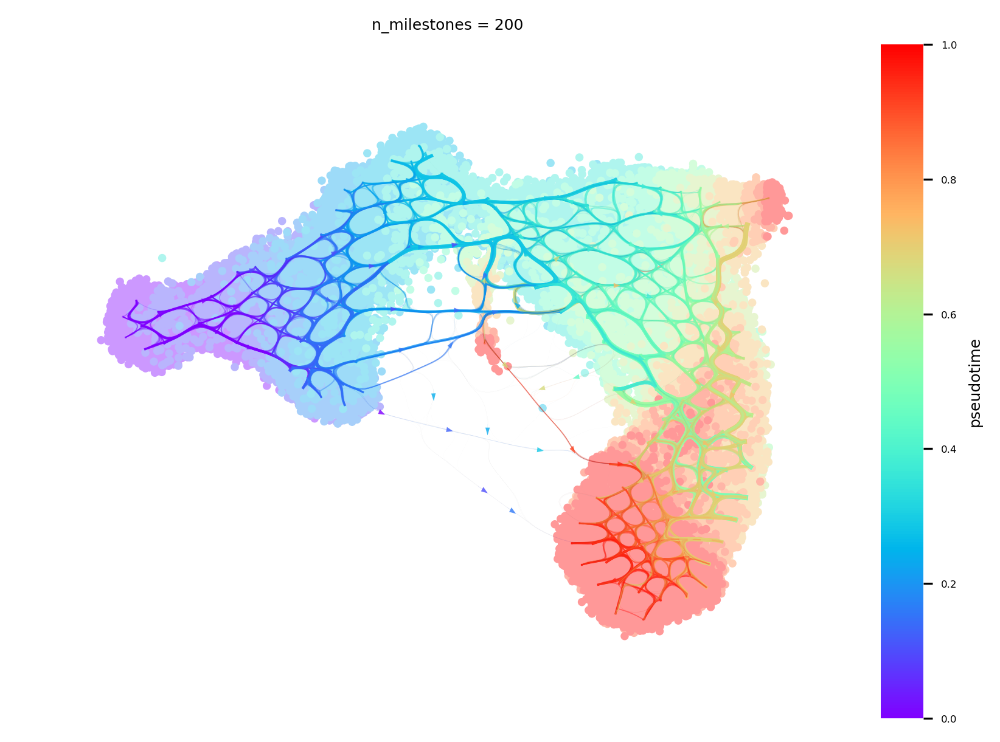

In [48]:
v0.embedding = atlas_embedding
f,ax=via.plot_atlas_view(via_object=v0,n_milestones=200, sc_labels_expression=true_labels_numeric, cmap='rainbow')


### Terminal states and pathways
The high-level direction from root to different final states is shown here. The final states are marked in yellow

100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00


2023-10-10 15:19:22.164658	Super cluster 1 is a super terminal with sub_terminal cluster 1
2023-10-10 15:19:22.166815	Super cluster 2 is a super terminal with sub_terminal cluster 2
2023-10-10 15:19:22.166871	Super cluster 12 is a super terminal with sub_terminal cluster 12
2023-10-10 15:19:22.166903	Super cluster 15 is a super terminal with sub_terminal cluster 15


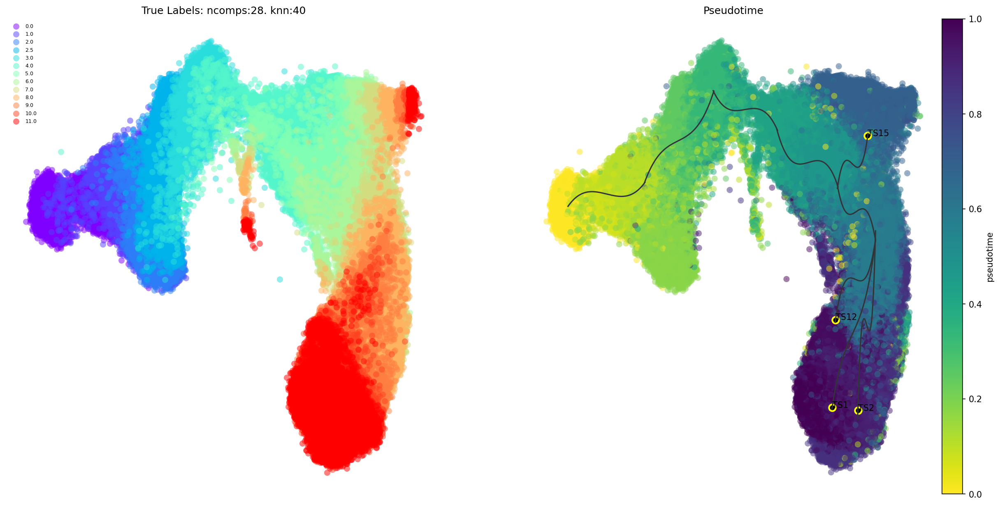

In [50]:
via.plot_trajectory_curves(via_object=v0, draw_all_curves=False) #Setting 'draw_all_curves' to False helps highlight major pathways
plt.show()


### Animated Trajectory
Fine grained vector fields in action

/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/pyVIA/core.py:1318: RuntimeWarning: Mean of empty slice.
  V_emb[i] = probs.dot(dX) - probs.mean() * dX.sum(0)
/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


2023-10-10 15:50:11.443156	Inside animated. File will be saved to location /home/user/Trajectory/Datasets/mESC/mesc_timeseries_stream_animation_oct2023.gif
total number of stream lines 410


  0%|          | 0/250 [00:00<?, ?it/s]
MovieWriter imagemagick unavailable; using Pillow instead.


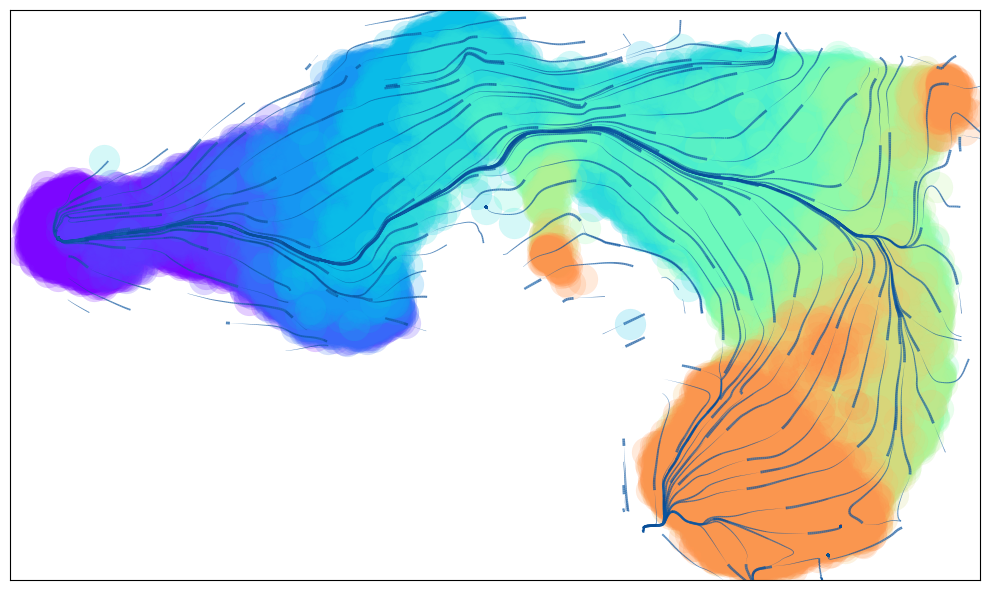

(<Figure size 1000x600 with 1 Axes>, <Axes: >)

In [62]:
via.animate_streamplot(v0, embedding=atlas_embedding,saveto='/home/user/Trajectory/Datasets/mESC/mesc_timeseries_stream_animation_oct2023.gif') #saveto='.../filename.gif')

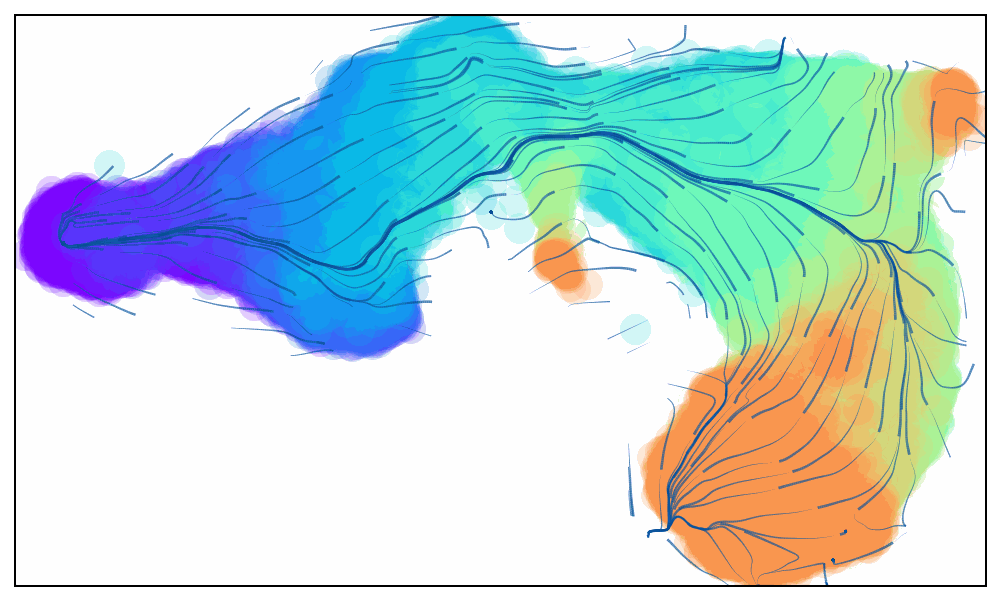

In [65]:
from IPython.display import Image
with open('/home/user/Trajectory/Datasets/mESC/mesc_timeseries_stream_animation_oct2023.gif','rb') as file:
    display(Image(file.read()))


## Not using time-series data to guide the analysis

When choosing not to use the available experimental time-stamps, we see that the overall Trajectory is more difficult to interpret and chronology is less clear (as seen when plotting the viagraph below)

In [66]:
knn=40
cluster_graph_pruning = 0.15
edgepruning_clustering_resolution=0.3
random_seed = 0
root = [0.0] #since the root corresponds to a group level initial state  we set dataset = 'group'

v_notime = via.VIA(adata.X, true_label=true_labels_numeric, edgepruning_clustering_resolution=edgepruning_clustering_resolution, edgepruning_clustering_resolution_local=1, knn=knn,
         cluster_graph_pruning=cluster_graph_pruning,  piegraph_arrow_head_width=0.6,
         too_big_factor=0.3, resolution_parameter=1,
         root_user=root, dataset='group', random_seed=random_seed,
         is_coarse=True, preserve_disconnected=False, pseudotime_threshold_TS=40, x_lazy=0.99,
         alpha_teleport=0.99)
v_notime.run_VIA()

2023-10-10 17:22:51.827898	Running VIA over input data of 89782 (samples) x 28 (features)
2023-10-10 17:22:51.827943	Knngraph has 40 neighbors
2023-10-10 17:23:32.546462	Finished global pruning of 40-knn graph used for clustering at level of 0.3. Kept 55.2 % of edges. 
2023-10-10 17:23:33.360124	Number of connected components used for clustergraph  is 1
2023-10-10 17:23:42.945437	Commencing community detection
2023-10-10 17:23:48.961073	Finished running Leiden algorithm. Found 24 clusters.
2023-10-10 17:23:49.031375	Merging 8 very small clusters (<10)
2023-10-10 17:23:49.047839	Finished detecting communities. Found 16 communities
2023-10-10 17:23:49.053183	Making cluster graph. Global cluster graph pruning level: 0.15
2023-10-10 17:23:49.514431	Graph has 1 connected components before pruning
2023-10-10 17:23:49.520669	Graph has 1 connected components after pruning
2023-10-10 17:23:49.521053	Graph has 1 connected components after reconnecting
2023-10-10 17:23:49.521919	0.0% links trimme

/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/pecanpy/graph.py:90: UserWarning: WARNING: Implicitly set node IDs to the canonical node ordering due to missing IDs field in the raw CSR npz file. This warning message can be suppressed by setting implicit_ids to True in the read_npz function call, or by setting the --implicit_ids flag in the CLI
  warnings.warn(


  0%|          | 0/1300 [00:00<?, ?it/s]

memory for rw2 hittings times  2. Using rw2 based pt
do scaling of pt
2023-10-10 17:23:54.358993	Identifying terminal clusters corresponding to unique lineages...
2023-10-10 17:23:54.359042	Closeness:[1, 4, 5, 9, 10, 13]
2023-10-10 17:23:54.359053	Betweenness:[1, 4, 5, 7, 8, 9, 10, 13]
2023-10-10 17:23:54.359059	Out Degree:[1, 2, 4, 5, 9, 10, 12, 13, 15]
2023-10-10 17:23:54.359431	Terminal clusters corresponding to unique lineages in this component are [1, 10, 5] 
TESTING rw2_lineage probability at memory 5
testing rw2 lineage probability at memory 5
g.indptr.size, 17


/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/pecanpy/graph.py:90: UserWarning: WARNING: Implicitly set node IDs to the canonical node ordering due to missing IDs field in the raw CSR npz file. This warning message can be suppressed by setting implicit_ids to True in the read_npz function call, or by setting the --implicit_ids flag in the CLI
  warnings.warn(


  0%|          | 0/1000 [00:00<?, ?it/s]

2023-10-10 17:23:57.703638	 Cluster or terminal cell fate 1 is reached 223.0 times
2023-10-10 17:23:57.741600	 Cluster or terminal cell fate 10 is reached 606.0 times
2023-10-10 17:23:57.770042	 Cluster or terminal cell fate 5 is reached 997.0 times
2023-10-10 17:23:57.790720	There are (3) terminal clusters corresponding to unique lineages {1: 10.0, 10: 4.0, 5: 5.0}
2023-10-10 17:23:57.790771	Begin projection of pseudotime and lineage likelihood
2023-10-10 17:24:02.856437	Cluster graph layout based on forward biasing
2023-10-10 17:24:02.857501	Starting make edgebundle viagraph...
2023-10-10 17:24:02.857518	Make via clustergraph edgebundle
2023-10-10 17:24:03.108995	Hammer dims: Nodes shape: (16, 2) Edges shape: (70, 3)
2023-10-10 17:24:03.112835	Graph has 1 connected components before pruning
2023-10-10 17:24:03.118067	Graph has 7 connected components after pruning
2023-10-10 17:24:03.129269	Graph has 1 connected components after reconnecting
2023-10-10 17:24:03.129927	55.7% links trim

/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/scipy/sparse/_index.py:103: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_intXint(row, col, x.flat[0])


/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/pyVIA/plotting_via.py:3092: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  sct = ax.scatter(node_pos[:, 0], node_pos[:, 1],


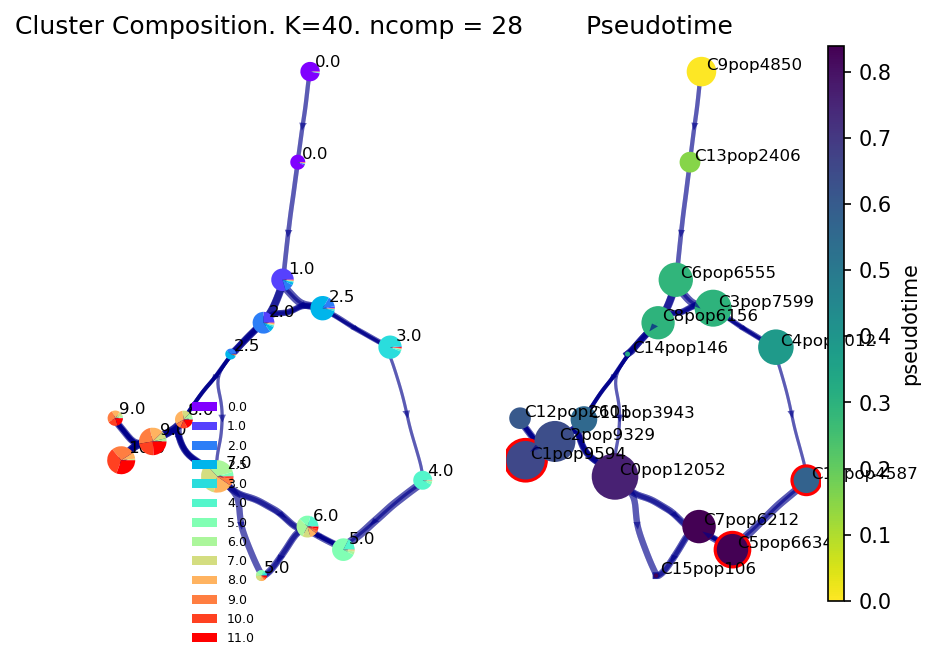

In [68]:
f, ax1, ax2 = via.plot_piechart_viagraph(via_object=v_notime)

### Using UMAP instead of Via's cartographic embeddings 

As shown below, if once uses UMAP instead of the TI adjusted embedding from Via, then the early and late stages are disconnected


In [75]:
import umap
embedding_umap = umap.UMAP(random_state=42, n_neighbors=15, init='spectral', min_dist=0.2).fit_transform(adata.X)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


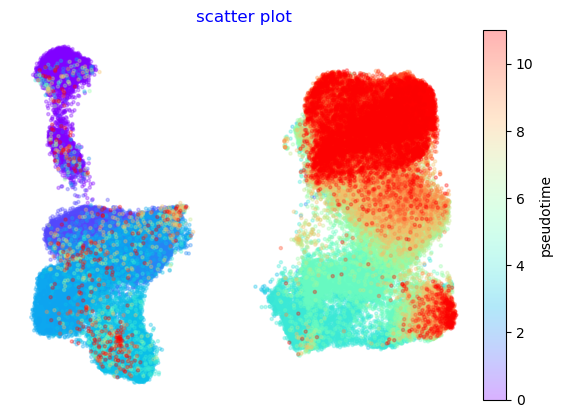

In [76]:
f,ax=via.plot_scatter(embedding=embedding_umap, labels=true_labels_numeric)